In [1]:
import sys
sys.path.append('../')

from CoreSampleImage import CoreSampleImage
from CoreSampleColumn import CoreSampleColumn
from utils import PixelScaler, smooth1D, apply_threshold_filter, show_images

import numpy as np
from skimage import dtype_limits, morphology, measure, img_as_uint, filters, img_as_float

import matplotlib.pyplot as plt

%matplotlib inline

In [2]:
exIm = CoreSampleImage(fname='../CorePhotos/CoreLab_jpegs/10620.0-10630.0__c1_resize.jpg')

processing file:  ../CorePhotos/CoreLab_jpegs/10620.0-10630.0__c1_resize.jpg


## Foreground

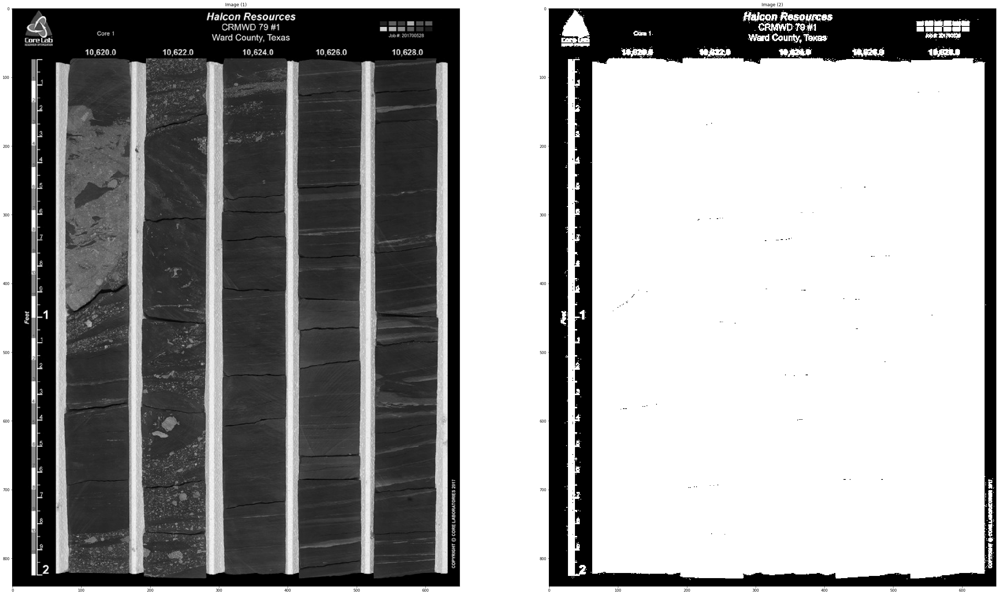

In [5]:
g, m = apply_threshold_filter(exIm.gimg, min_thresh=0.02)
show_images([g, m])

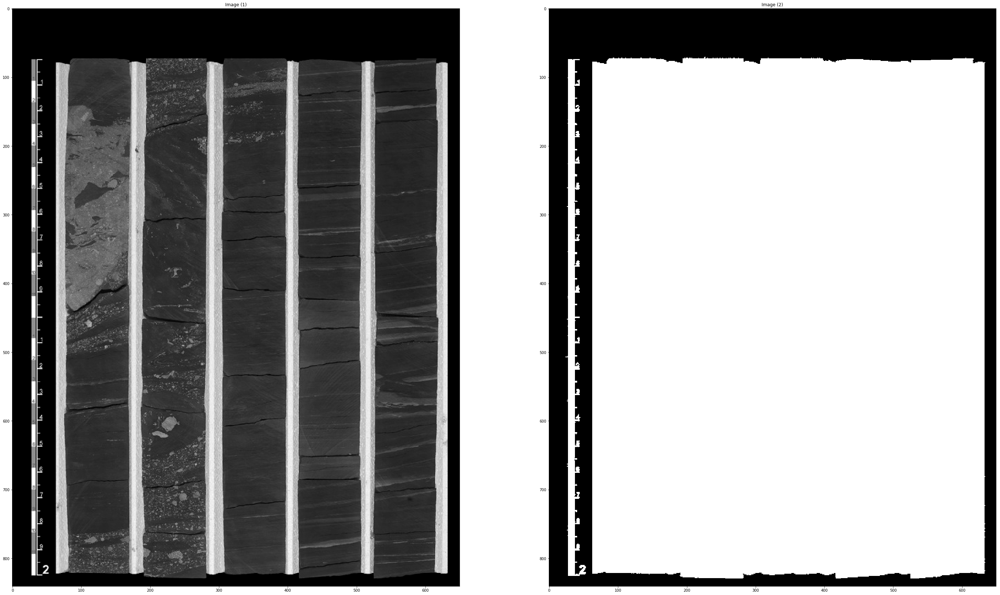

In [6]:
m = morphology.remove_small_holes(m, min_size=(m.size/10000))
m = morphology.remove_small_objects(m, min_size=(m.size/100))
g = m*g
show_images([g, m])

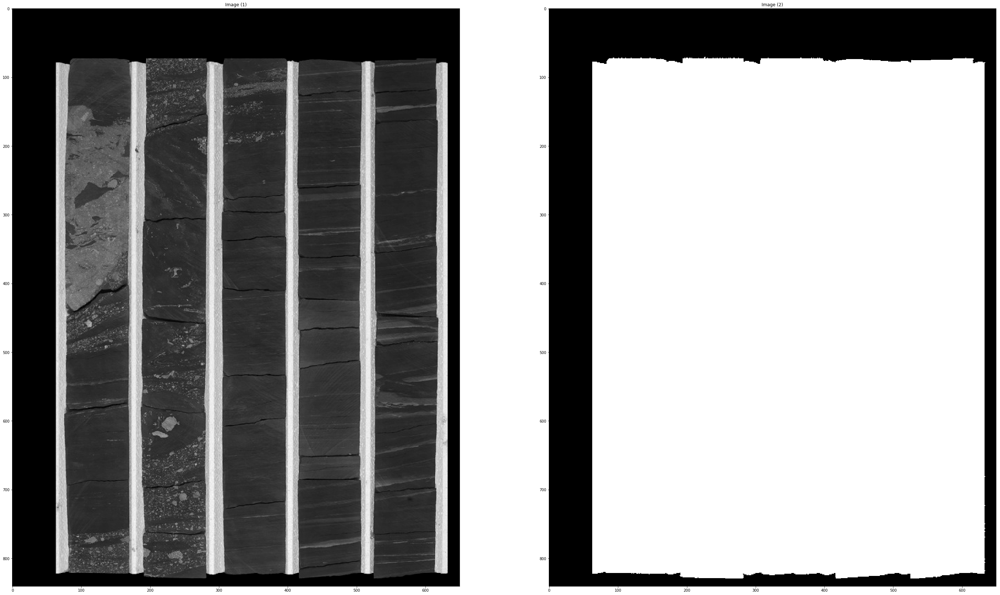

In [12]:
# remove the scale
m = morphology.remove_small_objects(m, min_size=(m.size/50))
g = m*g
show_images([g, m])

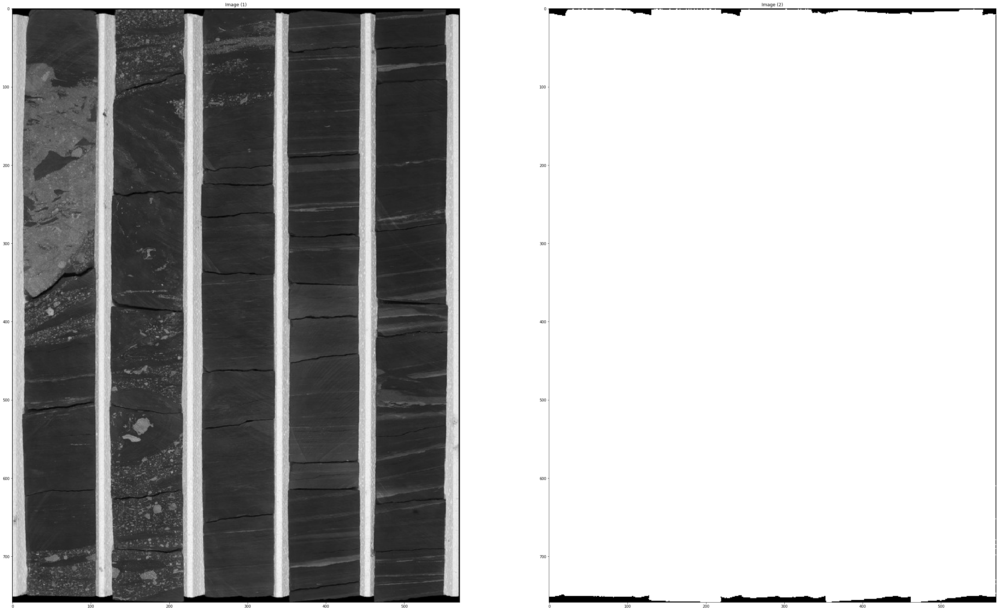

In [13]:
x0, y0, x1, y1 = measure.regionprops(measure.label(m))[0].bbox
g, m = g[x0:x1,y0:y1], m[x0:x1,y0:y1]
show_images([g, m])

skimage.filters.thresholding.threshold_isodata
skimage.filters.thresholding.threshold_li
skimage.filters.thresholding.threshold_mean
skimage.filters.thresholding.threshold_minimum
skimage.filters.thresholding.threshold_otsu
skimage.filters.thresholding.threshold_triangle
skimage.filters.thresholding.threshold_yen


(<matplotlib.figure.Figure at 0x7f06ef3f9cc0>,
 array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f06ef4f9358>,
       dtype=object))

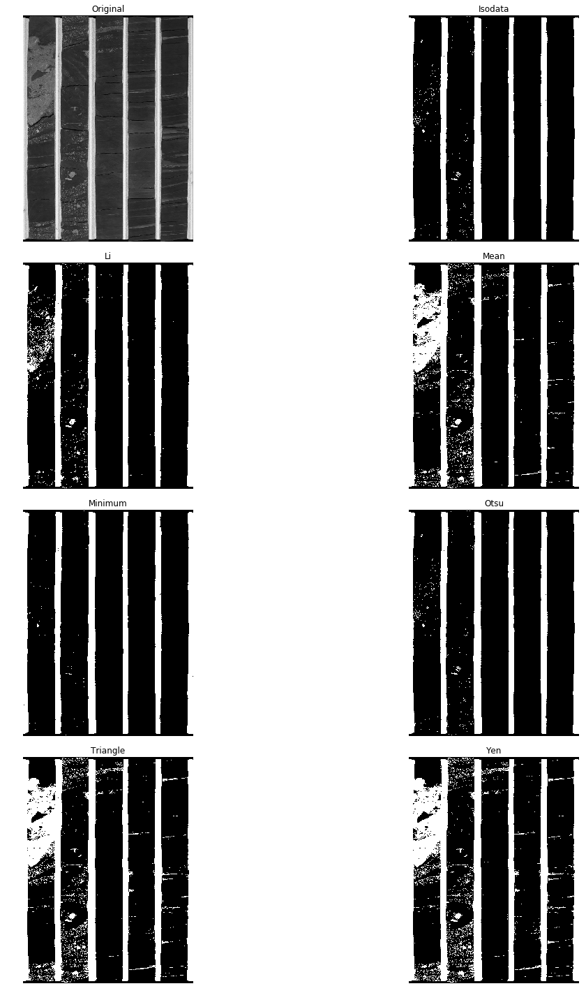

In [14]:
filters.try_all_threshold(g, figsize=(20,20))

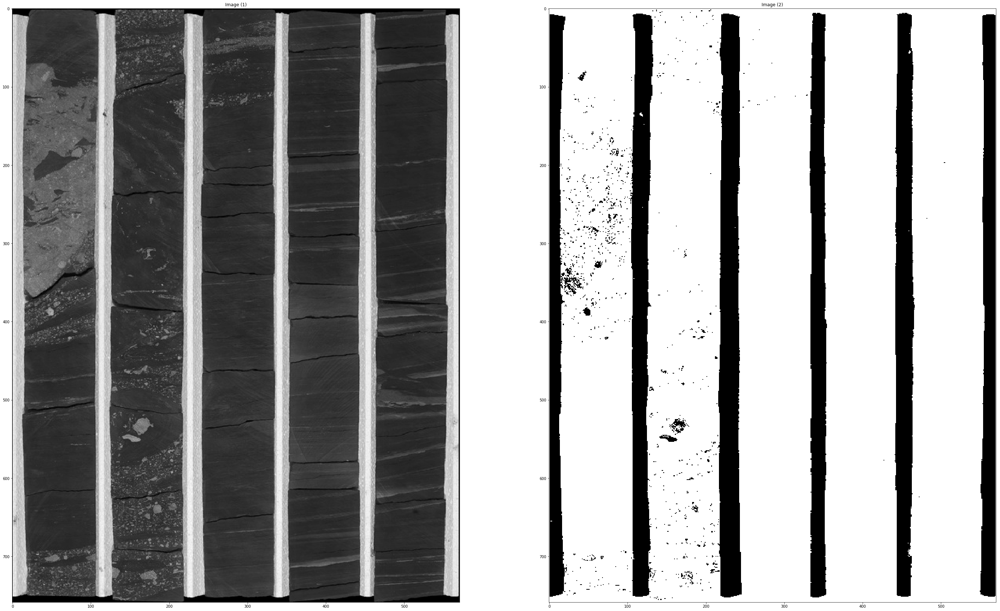

In [16]:
gg, mm = apply_threshold_filter(g, max_thresh=0.47)
show_images([g, mm])

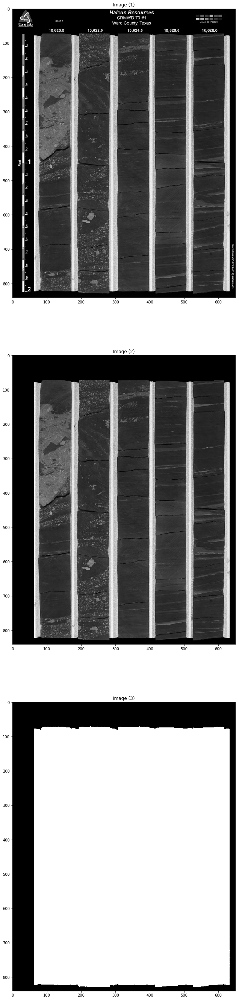

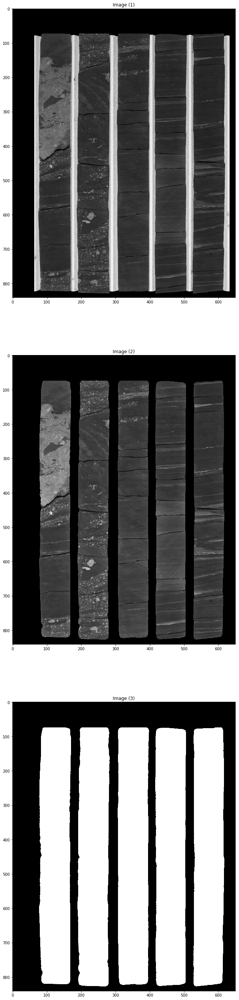

image.gimg.dtype =  float64


In [3]:
exIm.segment(show=True)

In [11]:
col = exIm.stack_columns()

column.uimg.dtype =  float64
column.uimg.dtype =  float64
column.uimg.dtype =  float64
column.uimg.dtype =  float64
column.uimg.dtype =  float64
float64  +  float64
column.uimg.dtype =  float64
float64  +  float64
column.uimg.dtype =  float64
float64  +  float64
column.uimg.dtype =  float64
float64  +  float64
column.uimg.dtype =  float64


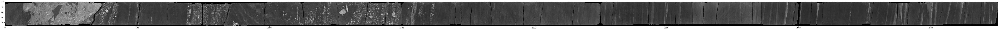

In [8]:
fig, ax = plt.subplots(figsize=(100,20))
ax.imshow(col.uimg.T)

/home/ross/anaconda3/lib/python3.6/site-packages/skimage/util/dtype.py:47: UserWarning: The default of `clip_negative` in `skimage.util.dtype_limits` will change to `False` in version 0.15.
  warn('The default of `clip_negative` in `skimage.util.dtype_limits` '


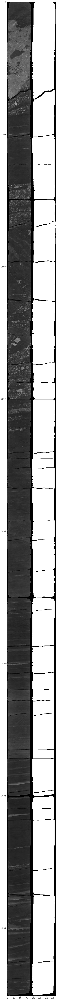

In [12]:
fig, ax = plt.subplots(figsize=(500,100))
im = col.uimg
col.mask_breaks(threshold_fraction=0.1)
ax.imshow(np.concatenate([im, col.uimg>0], axis=1),
          cmap='gray')

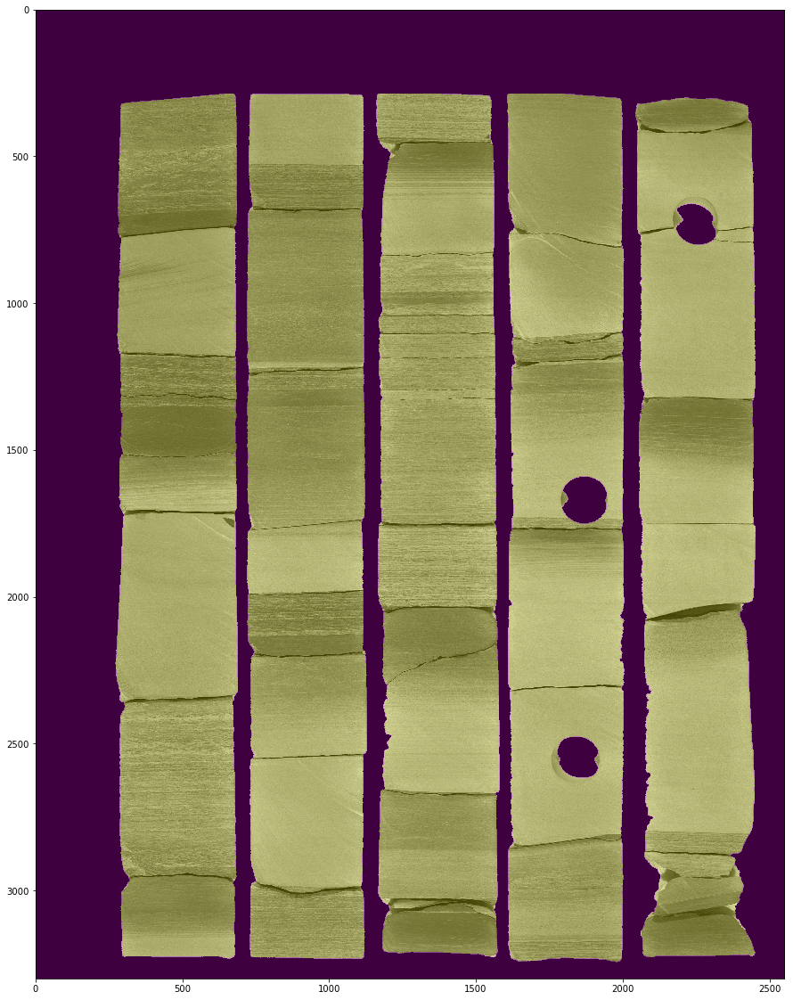

In [6]:
fig, ax = plt.subplots(figsize=(20,20))
#rock = morphology.binary_dilation(rock, selem=morphology.disk(10))
rock = morphology.binary_erosion(foreground & not_styro, selem=morphology.disk(10))
rock = morphology.binary_dilation(rock, selem=morphology.disk(8))
ax.imshow(gimg, cmap='gray')
ax.imshow(rock, cmap='spring', alpha=0.25)

In [ ]:
fig, ax = plt.subplots(figsize=(20,20))
ax.grid()
ax.imshow(gimg, cmap='gray')

In [7]:
from functools import reduce
from operator import add
from CoreSampleColumn import CoreSampleColumn

labels = measure.label(rock, background=0)
props = measure.regionprops(labels)
print("Num columns: ", len(props))

props.sort(key=lambda x: x.bbox[1]) # sort left->right

sample_material = gimg * rock

# create Column objects
cols = []
for prop in props:
    x0, y0, x1, y1 = prop.bbox
    cols.append(CoreSampleColumn(sample_material[x0:x1,y0:y1]))

# add them all left->right
catCol = reduce(add, cols)

Num columns:  5
column.uimg.dtype =  uint16
column.uimg.dtype =  uint16
column.uimg.dtype =  uint16
column.uimg.dtype =  uint16
column.uimg.dtype =  uint16
uint16  +  uint16
column.uimg.dtype =  uint16
uint16  +  uint16
column.uimg.dtype =  uint16
uint16  +  uint16
column.uimg.dtype =  uint16
uint16  +  uint16
column.uimg.dtype =  uint16


In [8]:
catCol.mask_breaks(threshold_fraction=0.13)
catCol.row_avg_luminance()
catCol.smooth_avg(bwidth = exIm.pix_scaler.in_to_px(0.1))

/home/ross/anaconda3/lib/python3.6/site-packages/skimage/util/dtype.py:47: UserWarning: The default of `clip_negative` in `skimage.util.dtype_limits` will change to `False` in version 0.15.
  warn('The default of `clip_negative` in `skimage.util.dtype_limits` '
/home/ross/Documents/DU_Courses/Project1/GeoCoreImageTools/CoreSampleTool/CoreSampleColumn.py:33: RuntimeWarning: Mean of empty slice.
  self.row_avg = np.apply_along_axis(lambda x: x[x.nonzero()].mean(), 1, self.uimg)
/home/ross/anaconda3/lib/python3.6/site-packages/numpy/core/_methods.py:80: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/home/ross/anaconda3/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2909: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)


column.uimg.dtype =  uint16
column.uimg.dtype =  uint16


array([ 22346.92402628,  22301.11159312,  22211.78151656, ...,
        21039.35524121,  21040.71737667,  21041.1886864 ])

column.uimg.dtype =  uint16


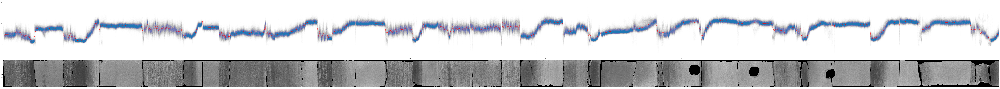

In [10]:
catCol.show(smooth=True, point_density=True)

column.uimg.dtype =  uint16
column.uimg.dtype =  uint16


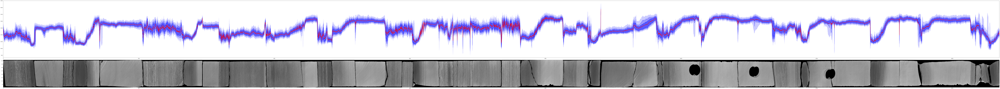

In [22]:
catCol.show(smooth=True, percentiles=True)

/home/ross/anaconda3/lib/python3.6/site-packages/ipykernel/__main__.py:3: RuntimeWarning: invalid value encountered in less
  app.launch_new_instance()
/home/ross/anaconda3/lib/python3.6/site-packages/ipykernel/__main__.py:3: RuntimeWarning: invalid value encountered in greater
  app.launch_new_instance()


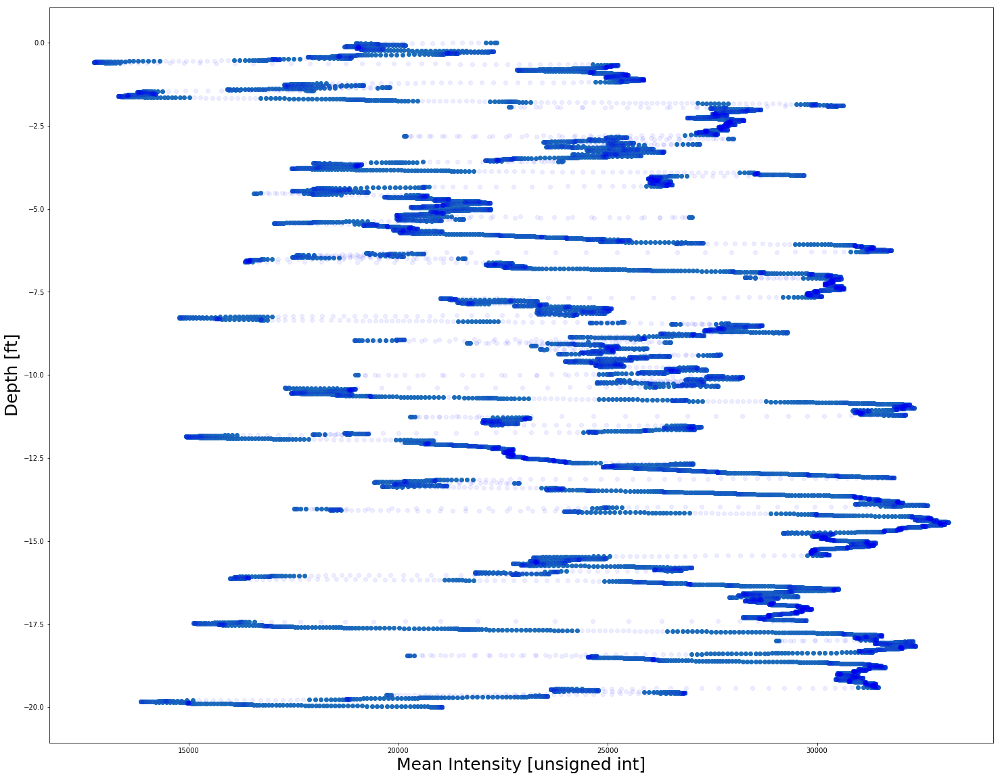

In [19]:
fig, ax = plt.subplots(figsize=(25,20))
grad = np.gradient(catCol.smoothed_avg)
goodVals = np.logical_and(np.logical_and(~np.isnan(grad), grad < 125), grad > -150)

means = catCol.smoothed_avg[goodVals]
xvals = np.linspace(0,-20, catCol.smoothed_avg.size)[goodVals]

#ax.hist(grad, bins=100)
ax.scatter(means, xvals)
ax.scatter(catCol.smoothed_avg, np.linspace(0,-20, catCol.smoothed_avg.size),
           color='blue', alpha=0.07)
ax.set_xlabel("Mean Intensity [unsigned int]", size=25)
ax.set_ylabel("Depth [ft]", size=25)

/home/ross/anaconda3/lib/python3.6/site-packages/skimage/util/dtype.py:47: UserWarning: The default of `clip_negative` in `skimage.util.dtype_limits` will change to `False` in version 0.15.
  warn('The default of `clip_negative` in `skimage.util.dtype_limits` '


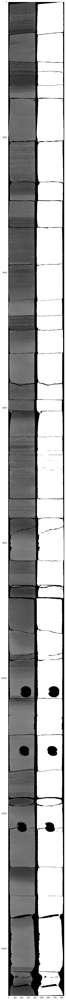

In [21]:
fig, ax = plt.subplots(figsize=(500,100))
catCol.mask_breaks(threshold_fraction=0.15)
ax.imshow(np.concatenate([img_as_float(catCol.unmasked), catCol.uimg>0], axis=1),
          cmap='gray')

In [23]:
np.savetxt('sample_row_avg.dat', catCol.row_avg)

In [24]:
np.save('sample_column', catCol.uimg)

In [27]:
exIm.pix_scaler.in_to_px(0.25)

30.697916666666668